In [1]:
from flair.data import Sentence
from flair.models import SequenceTagger
from tqdm import tqdm
import pandas as pd
import os
from datetime import datetime
import plotly.express as px
from bertopic import BERTopic
import re
from unidecode import unidecode
import string
import nltk
from sentence_transformers import SentenceTransformer
from umap import UMAP
import re

In [2]:
path = "/Users/aleistermontfort/documentos_hd/entropia_ai_2022/alt_projects/bertopic_mananera/amlo_scraping/transcriptions/"


In [3]:
ls_mananeras=[]
for year in ['18','19','20','21','22']:
    for file in os.listdir(path+year):
        if 'DS' not in file and 'conferencia' in file:
            f = open(path+year+'/'+file, "r")
            ls_mananeras.append(f.read())
            
            f.close()

In [4]:
len_mananera={}
dict_texts={}
for file in ls_mananeras:
    date = file[:8]
    if date =='17.004.1':
        date = '17.04.19'
    if date == '17.12.16':
        date = '17.12.19'
    if date == '03.03.30':
        date = '03.03.20'
    if len(date.split('.'))>2:
        len_mananera[datetime.strptime(date.strip(), '%d.%m.%y').date()]=len(file)
        dict_texts[date]= unidecode(file)
    else:
        splitted = date.split('.')
        date = splitted[0] + '.' + splitted[1][:2] +  '.' + splitted[1][2:]
        len_mananera[datetime.strptime(date.strip(), '%d.%m.%y').date()]=len(file)
        dict_texts[date]= unidecode(file.lower())
    

In [166]:
'adan augusto hernandez'.upper()

'ADAN AUGUSTO HERNANDEZ'

In [303]:
def create_regex(primeras_palabras,personajes):
    
    string=''
    ls_strings=[]
    for starter in primeras_palabras:
        string=string+starter+':(.*?)('
        for index,personaje in enumerate(personajes):
            if index!=len(personajes):
                string=string + personaje + '|'
            if index==len(personajes)-1:
                string=string + personaje
                string=string+')|'
        
        ls_strings.append(string)
    laststr=''
    for index, ls in enumerate(ls_strings):
 
            laststr=laststr+ls 
    return laststr[:-1]
        
    

In [342]:
'zoe alejandro robledo aburto'.upper()

'ZOE ALEJANDRO ROBLEDO ABURTO'

In [410]:
nombres=['PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR','MARCELO EBRARD CASAUBON','ALFONSO DURAZO MONTANO',
'ROSA ICELA RODRIGUEZ','LUIS CRESENCIO SANDOVAL GONZALEZ','JOSE RAFAEL OJEDA DURAN','ANDRES MANUEL LOPEZ OBRADOR',
            'ALEJANDRO ENCINA RODRIGUEZ','ALEJANDRO ENCINAS RODRIGUEZ','HUGO LOPEZ-GATELL',
            'RICARDO SHEFFIELD PADILLA','JORGE ALCOCER VARELA','ROCIO NAHLE GARCIA',
            'DAVID LEON ROMERO','OLGA SANCHEZ CORDERO','ADAN AUGUSTO HERNANDEZ',
         'SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN','JULIO SCHERER IBARRA','SECRETARIO JAVIER JIMENEZ ESPRIU',
        'CARLOS URZUA MACIAS','ESTEBAN MOCTEZUMA BARRAGAN','JAVIER JIMENEZ ESPRIU','ARTURO HERRERA GUTIERREZ',
        'LUISA MARIA ALCALDE LUJAN','ZOE ROBLEDO ABURTO','ZOE ALEJANDRO ROBLEDO ABURTO','MARIA LUISA ALBORES GONZALEZ','ARIADNA MONTIEL REYES',
        'JAVIER MAY RODRIGUEZ','JOSEFA GONZALEZ BLANCO ORTIZ MENA','VICTOR MANUEL TOLEDO MANZUR','GRACIELA MARQUEZ COLIN',
        'JESUS SEADE KURI','TATIANA CLOUTHIER CARRILLO','RAQUEL BUENROSTRO SANCHEZ','JORGE ARGANIS DIAZ LEAL',
        'JORGE NUÑO LARA','IRMA ERENDIRA SANDOVAL BALLESTEROS','ROBERTO SALCEDO AQUINO','DELFINA GOMEZ ALVAREZ',
        'LAURA VELAZQUEZ ALZUA','LETICIA RAMIREZ AMAYA','ROMAN MEYER FALCON','ALEJANDRA FRAUSTO GUERRERO','MIGUEL TORRUCO MARQUES',
         'MARIA ESTELA RIOS GONZALEZ', 'ALEJANDRO GERTZ MANERO','OCTAVIO ROMERO OROPEZA','MANUEL BARTLETT DIAZ',
         'JUAN ANTONIO FERRER AGUILA','CARLOS MARTINEZ VELAZQUEZ','MARIA ELENA ALVAREZ-BUYLLA','PABLO GOMEZ ALVAREZ',
         'SANTIAGO NIETO CASTILLO','VICTOR VILLALOBOS ARAMBULA','BLANCA JIMENEZ CISNEROS','JESUS RAMIREZ CUEVAS',
         'PEDRO ZENTENO SANTAELLA','MARGARITA RIOS FARJAT','ANTONIO MARTINEZ DAGNINO','ESTEBAN GARCIA PEREZ','AMELIA GUTIERREZ',
         'MARIA DEL ROCIO GARCIA PEREZ','NADINE GASMAN ZYLBERMANN','NURIA FERNANDEZ ESPRESATE','ANA GABRIELA GUEVARA ESPINOZA',
         'CLAUDIA SHEINBAUM PARDO','RICARDO MONREAL AVILA','LUIS RODRIGUEZ BUCIO','ALEJANDRO ANTONIO CALDERON ALIPI',
         'VICTOR MANUEL LAMOYI BOCANEGRA','CARLOS SANCHEZ MENESES','JUAN ANTONIO FERRER AGUILAR','IGNACIO OVALLE FERNANDEZ',
         'CARLOS SALAZAR LOMELIN'
         
         
         
        ]
primeras_palabras=['PREGUNTA','INTERLOCUTOR','INTERLOCUTORA','INTERVENCION']

In [394]:
'Luis Rodríguez Bucio'.upper()

'LUIS RODRÍGUEZ BUCIO'

In [407]:
for k,v in dict_texts.items():
    if 'SALAZAR'.upper() in v:
        print(k)

27.08.19
26.11.19
26.02.20
22.07.20
23.10.20
05.10.20
09.12.20
30.11.20
23.04.21
15.01.21


In [409]:
dict_texts['27.08.19']

"27.08.19 Version estenografica de la conferencia de prensa matutina del presidente Andres Manuel Lopez Obrador\n2019, Ano del Caudillo del Sur, Emiliano Zapata\nPRESIDENTE ANDRES MANUEL LOPEZ OBRADOR: Muy buenos dias.\nNos da mucho gusto tener esta conferencia para tratar un tema de gran importancia para la vida publica de Mexico, porque se demuestra que mediante el dialogo puede llegarse a acuerdos favorables para nuestra nacion.\nComo sabemos, habia diferencias, habia discrepancias, incluso se estaba a punto de acudir a tribunales internacionales por los contratos que se suscribieron en la construccion de gasoductos.\nHubo una controversia desde el inicio de nuestra administracion sobre los costos para la nacion de este servicio de transporte de gas. Hicimos un llamado a los empresarios para buscar un acuerdo.\nCuando cambia la mentalidad del pueblo, cambia todo.  Conferencia de prensa matutina.\nCuando cambia la mentalidad del pueblo, cambia todo. Conferencia de prensa matutina.\nP

In [ ]:
dictcount={}
for k,v in dict_texts.items():
    for word in v.split(" "):
        if word.isupper():
            if word not in dictcount:
                dictcount[word]=1
            else:
                dictcount[word]=dictcount[word]+1

In [385]:
dictcount

{'ANDRES': 27284,
 'MANUEL': 27514,
 'LOPEZ': 27567,
 'OBRADOR:': 27319,
 'Y': 10994,
 'GDF,': 0,
 'A': 3299,
 'UNAM,': 149,
 'O,': 27,
 'O': 896,
 'VIP.': 0,
 '?Y': 869,
 'Y,': 387,
 'ONU,': 207,
 'AUDIO': 2,
 'CONFERENCIA': 5,
 'DE': 4091,
 'PRENSA': 2,
 'PRESIDENTE': 79,
 'MEXICO\nPALACIO': 0,
 'NACIONAL,': 18,
 'PRI,': 212,
 'PAN,': 240,
 'E': 25,
 'ONU': 334,
 'INAI,': 35,
 'W': 53,
 'ROMERO': 182,
 'OROPEZA:': 119,
 'LUIS': 23,
 'CRESENCIO': 365,
 'SANDOVAL:': 24,
 'GERTZ': 57,
 'MANERO:': 53,
 'SAT,': 210,
 'SAT': 287,
 '2018\nPRESIDENTE': 1,
 'PEMEX': 7,
 'INE,': 229,
 'MORENA': 3,
 'B,': 36,
 'PPI': 0,
 'PEMEX.': 0,
 'ADN': 48,
 'SEDATU': 0,
 'GUTIERREZ:': 89,
 'DN-III.': 12,
 'PEMEX,': 2,
 '(...).\nPRESIDENTE': 1,
 'UNAM': 138,
 'UNAM?PRESIDENTE': 0,
 'UNAM.': 12,
 'I.': 111,
 'PIB.': 12,
 'LEGORRETA:': 0,
 'IP': 4,
 'MATUTINA': 0,
 'OBRADOR\nPALACIO': 0,
 '2018\n-PRESIDENTE': 1,
 '1979.\nY': 0,
 'COPARMEX,': 0,
 'MORENA,': 0,
 'B': 42,
 'XIX,': 58,
 'ISSSTE,': 4,
 'ISSSTE.':

In [392]:
def look_name(name):
    for k,v in dict_texts.items():
        if name in v:
            print(v)

In [412]:
create_regex(primeras_palabras,nombres)

'PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFIN

In [413]:
reg=r'PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTORA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTORA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERVENCION:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)'


In [414]:
regex =create_regex(primeras_palabras=['PREGUNTA','INTERLOCUTOR','INTERLOCUTORA','INTERVENCION'],personajes=nombres)
regex

'PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFIN

In [415]:
regex_final = r'PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTORA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|PREGUNTA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERLOCUTORA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)|INTERVENCION:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ANDRES MANUEL LOPEZ OBRADOR|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ|SECRETARIO ESTEBAN MOCTEZUMA BARRAGAN|JULIO SCHERER IBARRA|SECRETARIO JAVIER JIMENEZ ESPRIU|CARLOS URZUA MACIAS|ESTEBAN MOCTEZUMA BARRAGAN|JAVIER JIMENEZ ESPRIU|ARTURO HERRERA GUTIERREZ|LUISA MARIA ALCALDE LUJAN|ZOE ROBLEDO ABURTO|ZOE ALEJANDRO ROBLEDO ABURTO|MARIA LUISA ALBORES GONZALEZ|ARIADNA MONTIEL REYES|JAVIER MAY RODRIGUEZ|JOSEFA GONZALEZ BLANCO ORTIZ MENA|VICTOR MANUEL TOLEDO MANZUR|GRACIELA MARQUEZ COLIN|JESUS SEADE KURI|TATIANA CLOUTHIER CARRILLO|RAQUEL BUENROSTRO SANCHEZ|JORGE ARGANIS DIAZ LEAL|JORGE NUÑO LARA|IRMA ERENDIRA SANDOVAL BALLESTEROS|ROBERTO SALCEDO AQUINO|DELFINA GOMEZ ALVAREZ|LAURA VELAZQUEZ ALZUA|LETICIA RAMIREZ AMAYA|ROMAN MEYER FALCON|ALEJANDRA FRAUSTO GUERRERO|MIGUEL TORRUCO MARQUES|MARIA ESTELA RIOS GONZALEZ|ALEJANDRO GERTZ MANERO|OCTAVIO ROMERO OROPEZA|MANUEL BARTLETT DIAZ|JUAN ANTONIO FERRER AGUILA|CARLOS MARTINEZ VELAZQUEZ|MARIA ELENA ALVAREZ-BUYLLA|PABLO GOMEZ ALVAREZ|SANTIAGO NIETO CASTILLO|VICTOR VILLALOBOS ARAMBULA|BLANCA JIMENEZ CISNEROS|JESUS RAMIREZ CUEVAS|PEDRO ZENTENO SANTAELLA|MARGARITA RIOS FARJAT|ANTONIO MARTINEZ DAGNINO|ESTEBAN GARCIA PEREZ|AMELIA GUTIERREZ|MARIA DEL ROCIO GARCIA PEREZ|NADINE GASMAN ZYLBERMANN|NURIA FERNANDEZ ESPRESATE|ANA GABRIELA GUEVARA ESPINOZA|CLAUDIA SHEINBAUM PARDO|RICARDO MONREAL AVILA|LUIS RODRIGUEZ BUCIO|ALEJANDRO ANTONIO CALDERON ALIPI|VICTOR MANUEL LAMOYI BOCANEGRA|CARLOS SANCHEZ MENESES|JUAN ANTONIO FERRER AGUILAR|IGNACIO OVALLE FERNANDEZ|CARLOS SALAZAR LOMELIN|CARLOS SALAZAR LOMELIN)'


In [416]:

# Seleccionamos solo las preguntas
diccionario_de_preguntas={}

# regex1 = r'PREGUNTA:(.*?)PRESIDENTE ANDRES MANUEL'
# regex2 = r'INTERLOCUTOR:(.*?)PRESIDENTE ANDRES MANUEL|INTERLOCUTORA:(.*?)PRESIDENTE ANDRES MANUEL'
# regex3 = r'PREGUNTA:(.*?)PRESIDENTE ANDRES|INTERLOCUTOR:(.*?)PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|INTERLOCUTORA:\
# (.*?)PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|INTERLOCUTOR:(.*?)JESUS RAMIREZ CUEVAS|INTERLOCUTORA:(.*?)JESUS RAMIREZ CUEVAS|\
# INTERVENCION:(.*?)PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR'
#regex3 = r'PREGUNTA:(.*?)(PRESIDENTE ANDRES|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL|RICARDO SHEFFIELD PADILLA|JORGE ALCOCER VARELA|ROCIO NAHLE GARCIA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ)|INTERLOCUTOR:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL RAMIREZ|RICARDO SHEFFIELD PADILLA|ROCIO NAHLE GARCIA|JORGE ALCOCER VARELA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ)|INTERLOCUTORA:(.*?)(PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR|MARCELO EBRARD CASAUBON|ALFONSO DURAZO MONTANO|ROSA ICELA RODRIGUEZ|LUIS CRESENCIO SANDOVAL GONZALEZ|JOSE RAFAEL OJEDA DURAN|ALEJANDRO ENCINA RODRIGUEZ|ALEJANDRO ENCINAS RODRIGUEZ|HUGO LOPEZ-GATELL RAMIREZ|RICARDO SHEFFIELD PADILLA|ROCIO NAHLE GARCIA|JORGE ALCOCER VARELA|DAVID LEON ROMERO|OLGA SANCHEZ CORDERO|ADAN AUGUSTO HERNANDEZ)'

#regex4 = r'PREGUNTA: (Inaudible)(.*?)PRESIDENTE ANDRES MANUEL LOPEZ OBRADOR'

#regex2 = r'INTERLOCUTORA:(.*?)JESUS RAMIREZ'

for key, value in dict_texts.items():
    value=value.replace('PRSIDENTE','PRESIDENTE')   
    diccionario_de_preguntas[key]=[]

    result3 = re.findall(regex_final, value, re.DOTALL)
  
    for match in result3:
        if len(match)==0 or match=='':
            pass
        else:
            diccionario_de_preguntas[key].append(match)   
#     for match in result4:
#         diccionario_de_preguntas[key].append(match)   
#     diccionario_de_preguntas[key]=[x[0].strip() for x in result2]
#     diccionario_de_preguntas[key]=[x[0].strip() for x in result3]

preguntas={}
for key, value in diccionario_de_preguntas.items():
    preguntas[key]=[]
    for tupla in value:
        tupla = ''.join(tupla)
        final_string = tupla.strip().lower().replace('?','')
        jrc = re.findall(r"jesus ramirez cuevas:(.*?)interlocutor|jesus ramirez cuevas:(.*?)interlocutora", final_string, re.DOTALL)
        for match in jrc:
            jesusramirez=(" ".join(match).strip() )
            final_string = final_string.replace(jesusramirez," ").replace("jesus ramirez cuevas", " ").replace("presidente"," ").replace("buenos dias"," ").replace("senor", " ")
        final_string=final_string.replace('buenos dias', ' ').replace('presidente', ' ').replace('senor',' ').replace('gracias','').replace('(inaudible)','')
        #final_string = final_string.split('\n')
        final_string=remove_punctuation(final_string).strip()
        final_string = remove_preguntar_words(final_string)
        final_string = remove_stop_words(final_string)
        
        preguntas[key].append(final_string) if final_string is not None and final_string != ''  else None
        

In [417]:
lens=[]
for k,v in preguntas.items():
    for pregunta in v:
        if len(pregunta)>2500:
            print(k,':',pregunta)
            print('\n')

20.12.18 : quisiera hacerle dos primera relacionada guardia nacional favor detallenos ahora acerca plan construir territorio sedena santa fe desarrollos lujo fin financiar conformacion guardia nacional especifiquenos favor cuanto esperan obtener proyecto seria propiedad proyecto quedaria digamos gobierno cobraria alquiler tomando cuenta tambien hace mismo ano conflicto precisamente sedena gdf solicitando desincorporar terreno desarrollar inmueble otorgo tomo cuenta zona conflictiva vivienda mismo tema guardia nacional gustaria opina usted declaro colaboradora tatiana clouthier oposicion creacion guardia favor acerca primero libres siempre respetado opinion garantizamos derecho disentir derecha gusto discurso ayer payan fascismo discrepancias pluralidad sola voz pensamiento unico buscamos democracia entonces libres garantizar derecho disentir garanticen libertades opinen respetuosos doy instrucciones nadie digo hables nunca hecho nadie dirigentes cercanos amigos servidores publicos tamp

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

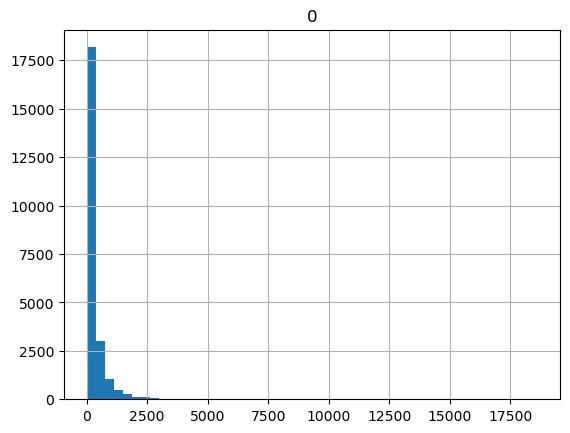

In [307]:
pd.DataFrame(lens).hist(bins=50)

In [132]:
for k, v in diccionario_de_preguntas.items():
    for intervencion in v:
        #print(intervencion)
        if len(intervencion)>150:
            print(intervencion)

In [47]:
def remove_punctuation(text):
    """
    Remove punctuation from a given string and return the cleaned text.
    """
    # Create a translation table with all punctuation characters mapped to None
    translator = str.maketrans('', '', string.punctuation)

    # Use the translation table to remove punctuation from the text
    cleaned_text = text.translate(translator)

    return cleaned_text
def remove_preguntar_words(text):
    """
    Remove words related to the verb 'preguntar' from a given text and return the cleaned text.
    """
    # Define a list of words related to the verb 'preguntar'
    preguntar_words = ['preguntar', 'pregunta', 'preguntas','preguntamos','preguntó', 'pregunto', 'preguntan', 'preguntando', 'preguntada', 'preguntadas', 'preguntados', 'preguntaba', 'preguntó', 'preguntárselo', 'preguntarse', 'preguntarle', 'preguntarles', 'preguntarles', 'preguntarse', 'preguntarían', 'preguntarías', 'preguntó']

    # Split the text into words and remove all words related to 'preguntar'
    cleaned_words = [word for word in text.split() if word.lower() not in preguntar_words]

    # Join the cleaned words to form the cleaned text
    cleaned_text = ' '.join(cleaned_words)

    return cleaned_text
nltk.download('stopwords')  # Descargar las palabras vacías si es necesario

from nltk.corpus import stopwords
stop_words = set(stopwords.words('spanish'))  # Conjunto de palabras vacías en español
for word in ['ok', "si", "presidente","okay"]:
    stop_words.add(word)
def remove_stop_words(text):
    """
    Elimina las palabras vacías de un texto dado y devuelve el texto limpio.
    """
    # Divide el texto en palabras y elimina todas las palabras vacías
    cleaned_words = [word for word in text.split() if word.lower() not in stop_words]

    # Une las palabras limpias para formar el texto limpio
    cleaned_text = ' '.join(cleaned_words)

    return cleaned_text



[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/aleistermontfort/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [49]:
diccionario_de_preguntas['25.04.19']

[(' Buenos dias, presidente. Andrea Meraz, de Grupo Formula.\nPreguntarle sobre esta aprobacion ya en la Camara de Diputados de la Reforma Educativa.\n?Que le responde a la oposicion que senala que se le deja otra vez al magisterio, a la CNTE, el control de plazas, presidente?\n',
  '',
  '',
  '',
  '',
  ''),
 (' Gracias, presidente, buenos dias.\nPara insistirle en este tema de la Reforma Educativa. Si desde su punto de vista no cree que se deja abierta la puerta para que sea el sindicato o los sindicatos quienes decidan sobre el reparto de las plazas. Esa seria la primera pregunta.\n',
  '',
  '',
  '',
  '',
  ''),
 ('',
  '',
  '',
  '',
  " Entonces, ?no hay riesgo que el sindicato meta mano a ocupar todas las plazas?\nPRESIDENTE ANDRES MANUEL LOPEZ OBRADOR: No, no, porque se va a ajustar a lo que va a aprobarse en su caso en las leyes, porque esto es reforma constitucional faltan las leyes secundarias.\nINTERLOCUTORA: Gracias, presidente.\nY el otro tema que le queria preguntar

In [48]:
preguntas['25.04.19']#'25.04.19' JESUS RAMIREZ

['andrea meraz grupo formula aprobacion camara diputados reforma educativa responde oposicion senala deja vez magisterio cnte control plazas',
 'insistirle tema reforma educativa punto vista cree deja abierta puerta sindicato sindicatos decidan reparto plazas seria primera',
 'entonces riesgo sindicato meta mano ocupar todas plazas va ajustar va aprobarse caso leyes reforma constitucional faltan leyes secundarias interlocutora tema queria hecho don miguel rincon parte consejo asesor usted compadrazgo participe licitacion libros texto licitacion millonaria pues empresa hace tiempo sabia participando legalmente impedido impedido puede participar podria participar interlocutora conflicto interes cercania personal legalmente problema podria participar protejo nadie acepto influyentismo nadie amigos familiares dije dia tome posesion solo hago cargo jesus ernesto menor edad responsabilizo actitud desempeno hijos esposa nadie familia absolutamente luego amigos compadres nadie protejo nadie in

In [ ]:
# test=[]
# for question in new_dict['25.04.19']:
#     question=question.replace('buenos dias', ' ').replace('presidente', ' ').replace('senor',' ').replace('\n',' ').replace('gracias','').replace('(inaudible)','')
#     question=remove_punctuation(question).strip()
#     question = remove_preguntar_words(question)
#     test.append(question) if question is not None and question != '' else None
# test
new_dict['05.05.22']

In [ ]:
dict_texts['05.05.22']

In [ ]:
duracion_mananeras = pd.DataFrame.from_dict(len_mananera,orient='index')
duracion_mananeras.columns=['duracion']

In [ ]:
duracion_mananeras['date']= duracion_mananeras.index
duracion_mananeras=duracion_mananeras.sort_values('date')

In [ ]:
duracion_mananeras['MA3'] = duracion_mananeras['duracion'].rolling(3).mean()
duracion_mananeras['MA7'] = duracion_mananeras['duracion'].rolling(7).mean()
duracion_mananeras['MA15'] = duracion_mananeras['duracion'].rolling(15).mean()
duracion_mananeras['MA30'] = duracion_mananeras['duracion'].rolling(30).mean()

In [ ]:
fig = px.line(duracion_mananeras, x=duracion_mananeras.date, y=duracion_mananeras.MA15, title='Duración de las conferencias mañaneras de AMLO')
fig.show()

In [418]:
tagger = SequenceTagger.load("flair/ner-spanish-large")


2023-04-17 20:56:23,846 SequenceTagger predicts: Dictionary with 20 tags: <unk>, O, S-LOC, S-ORG, B-PER, I-PER, E-PER, S-MISC, B-ORG, E-ORG, S-PER, I-ORG, B-LOC, E-LOC, B-MISC, E-MISC, I-MISC, I-LOC, <START>, <STOP>


In [ ]:
# make example sentence
for i in tqdm(range(1)):
    sentence = Sentence(texto_sin_amlo)

# predict NER tags
    tagger.predict(sentence)

# print sentence
print(sentence)

In [ ]:
sentence.text.split("\n")

In [ ]:
(sentence.get_labels())

In [ ]:
list(new_dict.values())[0]

In [419]:
all_questions=[]
for questions in preguntas.values():
    all_questions.append(questions)
all_questions= [item for sublist in all_questions for item in sublist]

In [420]:
topic_model = BERTopic()

In [421]:
topics, probs = topic_model.fit_transform(all_questions)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [422]:
topic_model.get_topic(40)

[('militares', 0.06856053402196075),
 ('militar', 0.04400253476896517),
 ('civil', 0.015803487065008275),
 ('mando', 0.014529101249119948),
 ('guardia', 0.013311114013124098),
 ('confrontacion', 0.012762880963890595),
 ('vi', 0.011554680456046048),
 ('rango', 0.011433865464977629),
 ('mandos', 0.009993931371544642),
 ('multitudes', 0.009942022058158423)]

In [423]:
topic_model.get_topic_info()['Name'].to_list() #si_mas_tambien_usted

['-1_mexico_tambien_usted_mas',
 '0_fiscalia_fiscal_general_republica',
 '1_casaubon_marcelo_ebrard_canciller',
 '2_gobernador_gobernadores_gobernadora_tamaulipas',
 '3_empresas_empresa_empresarios_empresarial',
 '4_va_reunir_biden_ir',
 '5_migrantes_migrante_hermanos_unidos',
 '6_mexico_ciudad_mexicanos_vivo',
 '7_gas_gasolina_combustible_gasolineras',
 '8_electoral_electorales_ine_reforma',
 '9_hospital_hospitales_pacientes_medicos',
 '10_informacion_informe_informaron_informado',
 '11_posibilidad_actividades_juridicamente_bando',
 '12_secretaria_gobernacion_secretario_secretariado',
 '13_aeropuerto_lucia_santa_aeropuertos',
 '14_radio_radios_radiodifusion_calzada',
 '15_cartel_carteles_calderon_sinaloa',
 '16_muchas_amable_companeros_director',
 '17_maya_tren_yucatan_tramo',
 '18_planta_planteamiento_plantas_planteando',
 '19_gobierno_gobiernos_911_mareo',
 '20_politica_politico_politicos_analfabeto',
 '21_coronavirus_virus_salud_atender',
 '22_secretaria_trabajo_funcion_san',
 '23_

In [424]:
topic_model.visualize_topics()

In [425]:


# Prepare embeddings
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(all_questions, show_progress_bar=True)



Batches:   0%|          | 0/738 [00:00<?, ?it/s]

In [428]:
# Train BERTopic
topic_model = BERTopic(nr_topics=30).fit(all_questions, embeddings)

# Run the visualization with the original embeddings
topic_model.visualize_documents(all_questions, embeddings=embeddings)

# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
topic_model.visualize_documents(all_questions, reduced_embeddings=reduced_embeddings)


In [429]:
# topic_model = BERTopic(verbose=True)
# topics, probs = topic_model.fit_transform(docs)
hierarchical_topics = topic_model.hierarchical_topics(all_questions)

100%|███████████████████████████████████████████| 29/29 [00:00<00:00, 67.59it/s]


In [430]:
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)


In [433]:
topic_model.visualize_barchart(top_n_topics=30)
